In [1]:
import os, warnings
from pathlib import Path

import numpy as np
import dynamo as dyn
import spateo as st
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packag

In [2]:
from typing import Optional, Tuple, Union

import matplotlib as mpl
import numpy as np
from pyvista import PolyData, UniformGrid, UnstructuredGrid

try:
    from typing import Literal
except ImportError:
    from typing_extensions import Literal


def add_model_labels(
        model: Union[PolyData, UnstructuredGrid, UniformGrid],
        labels: np.ndarray,
        key_added: str = "groups",
        where: Literal["point_data", "cell_data"] = "cell_data",
        colormap: Union[str, list, dict, np.ndarray] = "rainbow",
        alphamap: Union[float, list, dict, np.ndarray] = 1.0,
        mask_color: Optional[str] = "gainsboro",
        mask_alpha: Optional[float] = 0.0,
        inplace: bool = False,
) -> Tuple[Optional[PolyData or UnstructuredGrid], Optional[Union[str]]]:
    model = model.copy() if not inplace else model
    labels = np.asarray(labels).flatten()

    cu_arr = np.sort(np.unique(labels), axis=0).astype(object)
    raw_labels_hex = labels.copy().astype(object)
    raw_labels_alpha = labels.copy().astype(object)
    raw_labels_hex[raw_labels_hex == "mask"] = mpl.colors.to_hex(mask_color)
    raw_labels_alpha[raw_labels_alpha == "mask"] = mask_alpha

    # Set raw hex.
    if isinstance(colormap, str):
        if colormap in list(mpl.colormaps()):
            lscmap = mpl.cm.get_cmap(colormap)
            raw_hex_list = [mpl.colors.to_hex(lscmap(i)) for i in np.linspace(0, 1, len(cu_arr))]
            for label, color in zip(cu_arr, raw_hex_list):
                raw_labels_hex[raw_labels_hex == label] = color
        else:
            raw_labels_hex[raw_labels_hex != "mask"] = mpl.colors.to_hex(colormap)
    elif isinstance(colormap, dict):
        for label, color in colormap.items():
            raw_labels_hex[raw_labels_hex == label] = mpl.colors.to_hex(color)
    elif isinstance(colormap, list) or isinstance(colormap, np.ndarray):
        raw_hex_list = np.array([mpl.colors.to_hex(color) for color in colormap]).astype(object)
        for label, color in zip(cu_arr, raw_hex_list):
            raw_labels_hex[raw_labels_hex == label] = color
    else:
        raise ValueError("`colormap` value is wrong." "\nAvailable `colormap` types are: `str`, `list` and `dict`.")

    # Set raw alpha.
    if isinstance(alphamap, float) or isinstance(alphamap, int):
        raw_labels_alpha[raw_labels_alpha != "mask"] = alphamap
    elif isinstance(alphamap, dict):
        for label, alpha in alphamap.items():
            raw_labels_alpha[raw_labels_alpha == label] = alpha
    elif isinstance(alphamap, list) or isinstance(alphamap, np.ndarray):
        raw_labels_alpha = np.asarray(alphamap).astype(object)
    else:
        raise ValueError(
            "`alphamap` value is wrong." "\nAvailable `alphamap` types are: `float`, `list` and `dict`."
        )

    # Set rgba.
    labels_rgba = [mpl.colors.to_rgba(c, alpha=a) for c, a in zip(raw_labels_hex, raw_labels_alpha)]
    labels_rgba = np.array(labels_rgba).astype(np.float32)

    # Added rgba of the labels.
    if where == "point_data":
        model.point_data[f"{key_added}_rgba"] = labels_rgba
    else:
        model.cell_data[f"{key_added}_rgba"] = labels_rgba

    plot_cmap = None

    # Added labels.
    if where == "point_data":
        model.point_data[key_added] = labels
    else:
        model.cell_data[key_added] = labels

    return model if not inplace else None, plot_cmap

## Load the data

In [3]:
sample_id = "E7_8h"
os.chdir(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_{sample_id}_germ_layer_new")
cpo = [(41, 1209, 57), (13, 8, -3), (0, 0, 1)]

out_image_path = f"image/germband_morphofield/morpho_curl"
Path(out_image_path).mkdir(parents=True, exist_ok=True)

In [4]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband_v4_curl.h5ad")

germ_pc = st.tdr.read_model(f"morpho_models/germband_morphometrics_pc_model.vtk")
germ_mesh = st.tdr.read_model(f"morpho_models/germband_morphometrics_mesh_model.vtk")
trajectory_model = st.tdr.read_model(f"morpho_models/germband_morphofield_trajectory_model.vtk")
germ_adata

AnnData object with n_obs × n_vars = 12585 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho', 'glm_degs', 'log1p', 'pp'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

## GLM DEGs

In [5]:
germ_adata.X= germ_adata.layers["X_counts"].copy()
sc.pp.normalize_total(germ_adata)
sc.pp.log1p(germ_adata)

In [6]:
st.tl.glm_degs(
    adata=germ_adata,
    fullModelFormulaStr=f'~cr(morpho_curl, df=3)',
    key_added="glm_degs",
    qval_threshold=0.01,
    llf_threshold=-100,
)
print(germ_adata.uns["glm_degs"]["glm_result"])

|-----? Gene expression matrix must be normalized by the size factor, please check if the input gene expression matrix is correct.If you don't have the size factor normalized gene expression matrix, please run `dynamo.pp.normalize_cell_expr_by_size_factors(skip_log = True)`.
|-----> [Detecting genes via Generalized Additive Models (GAMs)] in progress: 100.0000%
|-----> [Detecting genes via Generalized Additive Models (GAMs)] finished [581.4896s]
               status family  log-likelihood      pval      qval
Df31               ok    NB2   -11954.665039  0.000000  0.000000
Obp99a             ok    NB2   -11391.395508  0.000000  0.000000
HmgD               ok    NB2   -10429.776367  0.000000  0.000000
lola               ok    NB2    -6032.876465  0.000000  0.000000
lncRNA:CR30009     ok    NB2    -5318.819824  0.000000  0.000000
...               ...    ...             ...       ...       ...
Rbm13              ok    NB2    -1217.959106  0.001053  0.009791
Nost               ok    NB2  

In [8]:
glm_data = germ_adata.uns["glm_degs"]["glm_result"]
glm_data= glm_data.loc[glm_data["log-likelihood"] >= -2000, :]
glm_data= glm_data.loc[glm_data["log-likelihood"] <= -1000, :]
# glm_data= glm_data.loc[glm_data["pval"] >= 1e-10, :]
glm_data= glm_data.loc[glm_data["pval"] <= 1e-5, :]
print(glm_data)

               status family  log-likelihood          pval          qval
pip                ok    NB2    -1093.142700  0.000000e+00  0.000000e+00
nerfin-1           ok    NB2    -1841.596680  1.070592e-42  5.798321e-40
lncRNA:CR45388     ok    NB2    -1654.392822  2.691411e-34  1.040679e-31
Gmap               ok    NB2    -1733.206543  4.763074e-33  1.758007e-30
chinmo             ok    NB2    -1125.815430  5.508981e-31  1.720497e-28
...               ...    ...             ...           ...           ...
chif               ok    NB2    -1405.561035  8.100295e-06  1.665175e-04
lncRNA:CR44357     ok    NB2    -1201.327393  8.379819e-06  1.713958e-04
peb                ok    NB2    -1303.521362  8.443138e-06  1.722570e-04
Men                ok    NB2    -1119.579834  8.684560e-06  1.762966e-04
U2af38             ok    NB2    -1270.026733  9.464639e-06  1.898608e-04

[125 rows x 5 columns]


In [10]:
GNs = [
    "Rab30", "rhea", "Mtl", "srp", "raw", "peb", "ecd", "EcR", "Egfr", "ush", "Rac2", "Rac1", "tup", "yrt", "POSH",
    "sr", "InR", "ena","Ndg", "Ret", "scb", "mys", "Zasp52", "muskelin", "Pten", "Itgbn", "Fit2", "Fit1", "m", "mew",
    "Ilk", "tyn", "Sema2b", "if", "top", "flb", "Egfr", "inr", "hnt", 'crb'
]
new_GNs = []
for i in GNs:
    if i in germ_adata.uns["glm_degs"]["glm_result"].index:
        new_GNs.append(i)

print(germ_adata.uns["glm_degs"]["glm_result"].loc[new_GNs, :])

     status family  log-likelihood          pval          qval
rhea     ok    NB2    -1749.340088  8.231107e-17  9.282859e-15
peb      ok    NB2    -1303.521362  8.443138e-06  1.722570e-04
Rac2     ok    NB2    -1616.096069  8.084010e-06  1.665175e-04
ena      ok    NB2    -1861.183105  6.193464e-12  4.261943e-10


In [9]:
st.pl.glm_fit(
    adata=germ_adata,
    genes=list(glm_data.index),
    ncols=5,
    feature_x="morpho_curl",
    feature_y="expression",
    glm_key="glm_degs",
    save_show_or_return="all",
    color_key="morpho_curl",
    color_key_cmap="vlag",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_glm_degs_fit"), prefix=None, ext="pdf", dpi=100)
)

Saving figure to image/germband_morphofield/morpho_curl/E7_8h_germband_morpho_curl_glm_degs_fit.pdf...
Done


In [9]:
selected_genes = ["Acbp5", "Abd-B", "fkh", "nyo", "Dph5", "CG6910", "CG7841", "CG7519", "tai", "Rab32", "Gart", "CG31463", "CG7519",
                  "CG33993", "CG33099", "CG2930", "RhoGEF64C", "CG44286", "neo", "FoxL1", "CG1273", "Tep4", "bbg", "Doc3", "CG4069",
                  "CG32425", "Npc2g", "Pdp1", "fok", "DNaseII", "CG6937", "CG8468", "clu", "CG11563", "Galt", "Surf6", "ppl", "CG12522", "mRpL23", "Chchd2", "ppan", "peb"]
st.pl.glm_fit(
    adata=germ_adata,
    genes=selected_genes,
    ncols=5,
    feature_x="morpho_curl",
    feature_y="expression",
    glm_key="glm_degs",
    save_show_or_return="all",
    color_key="morpho_curl",
    color_key_cmap="vlag",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_selected_glm_degs_fit"), prefix=None, ext="pdf", dpi=100)
)

Saving figure to image/germband_morphofield/morpho_curl/E7_8h_germband_morpho_curl_selected_glm_degs_fit.pdf...
Done


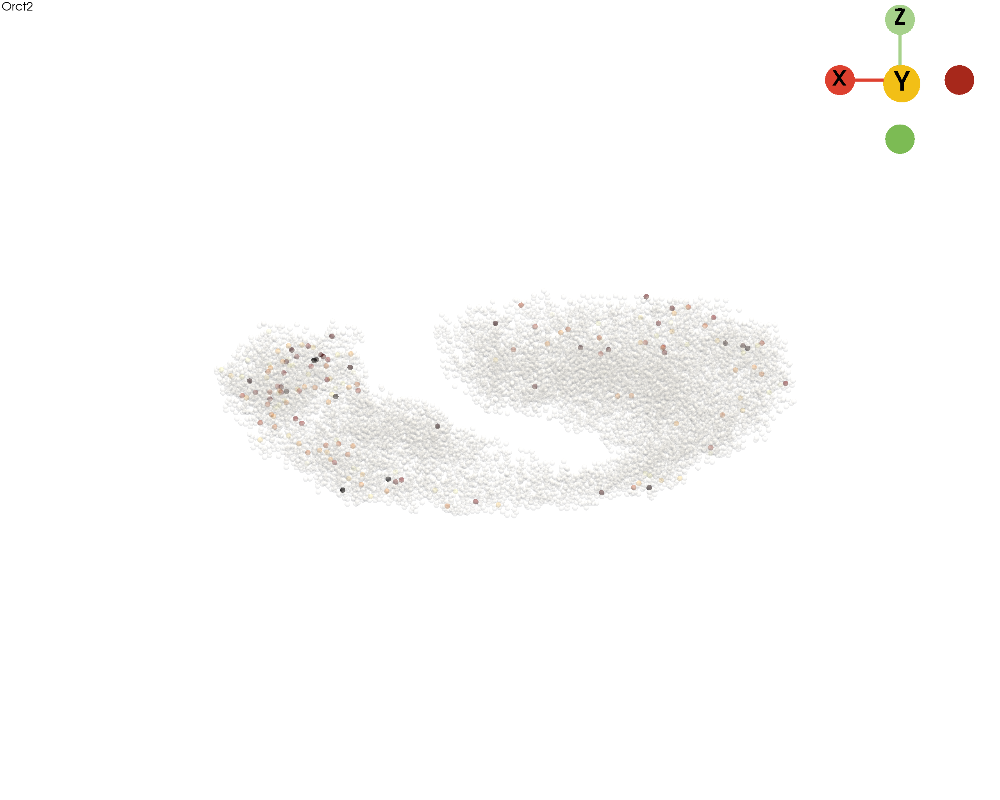

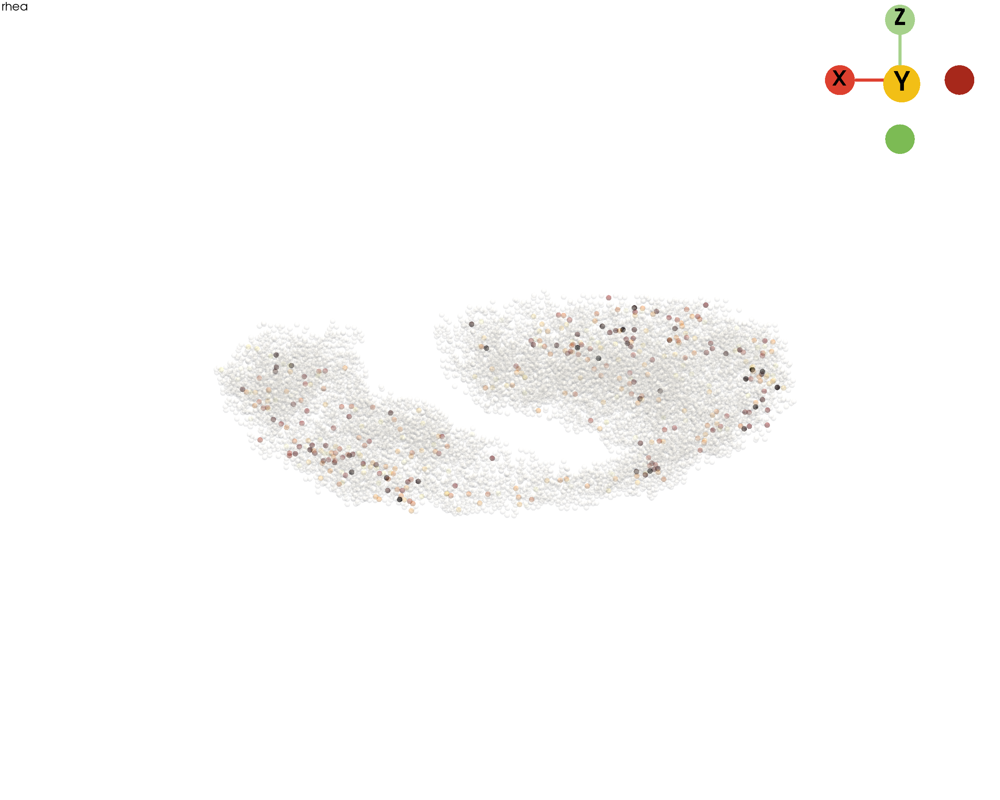

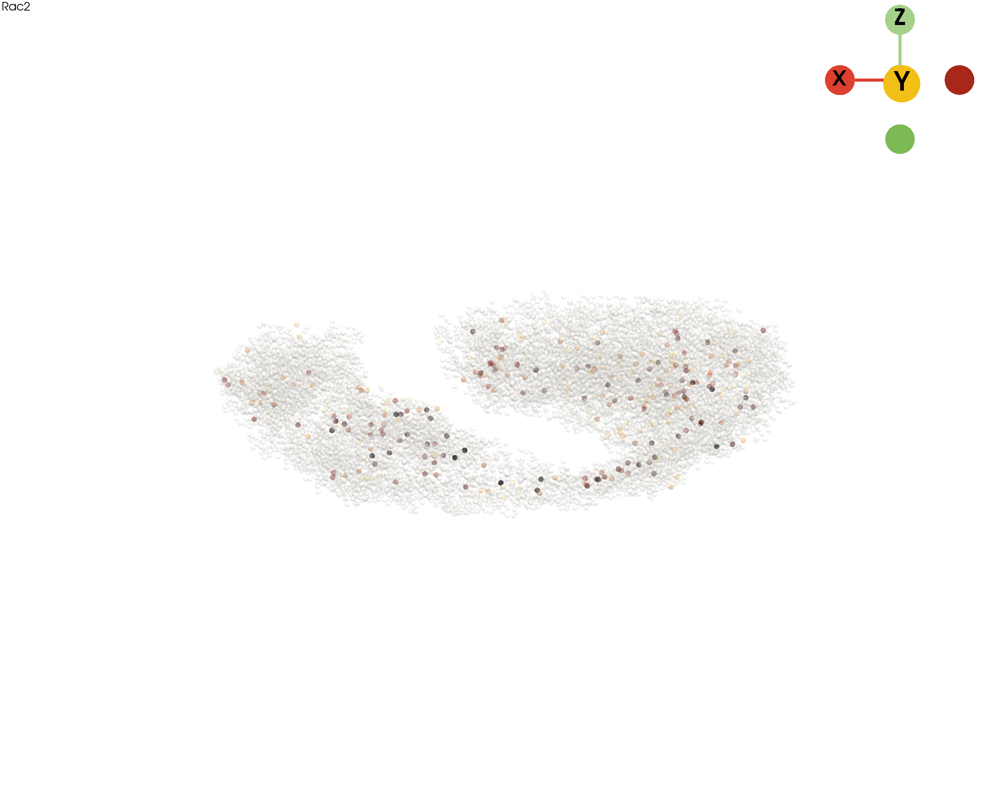

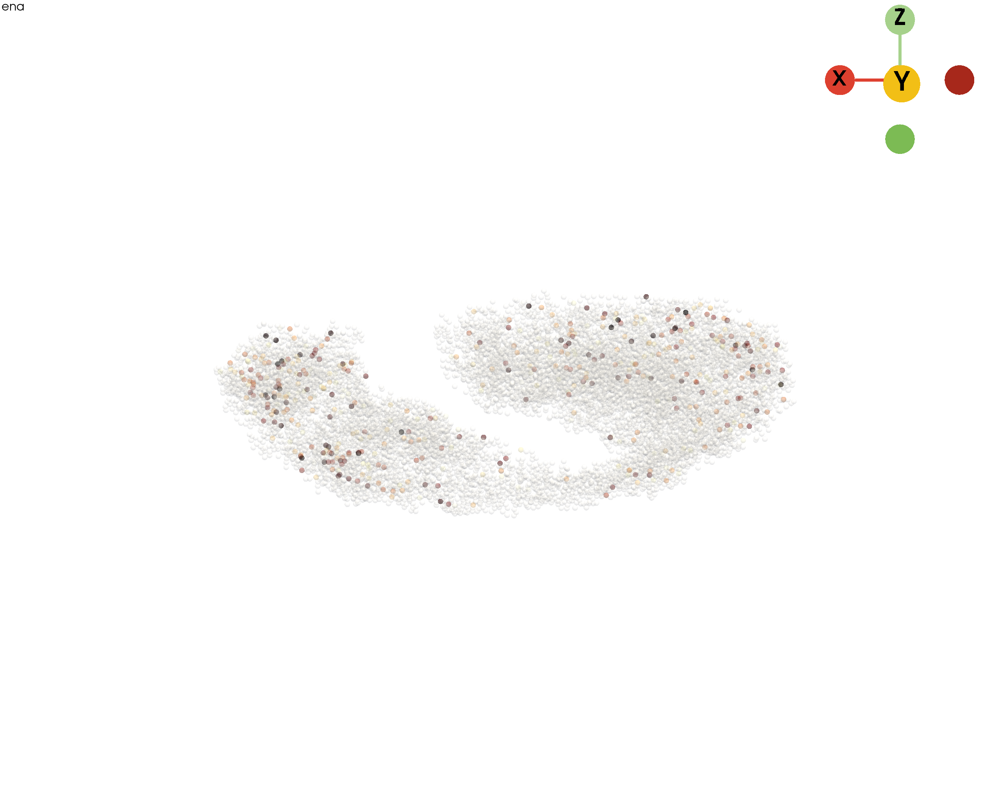

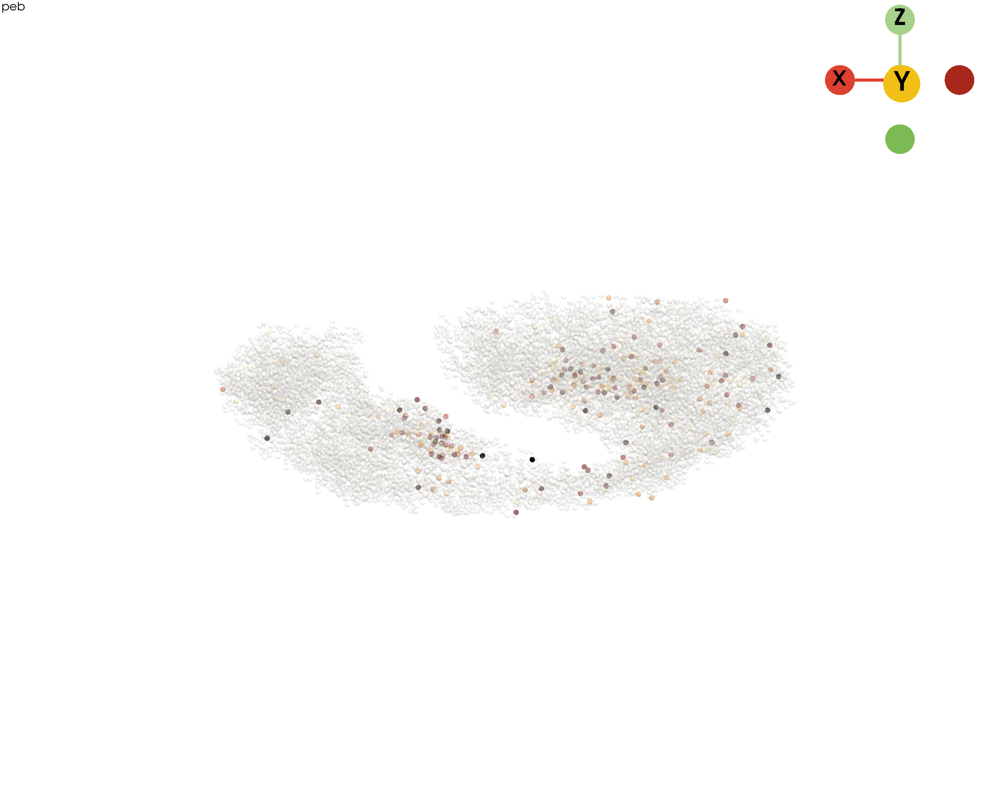

...

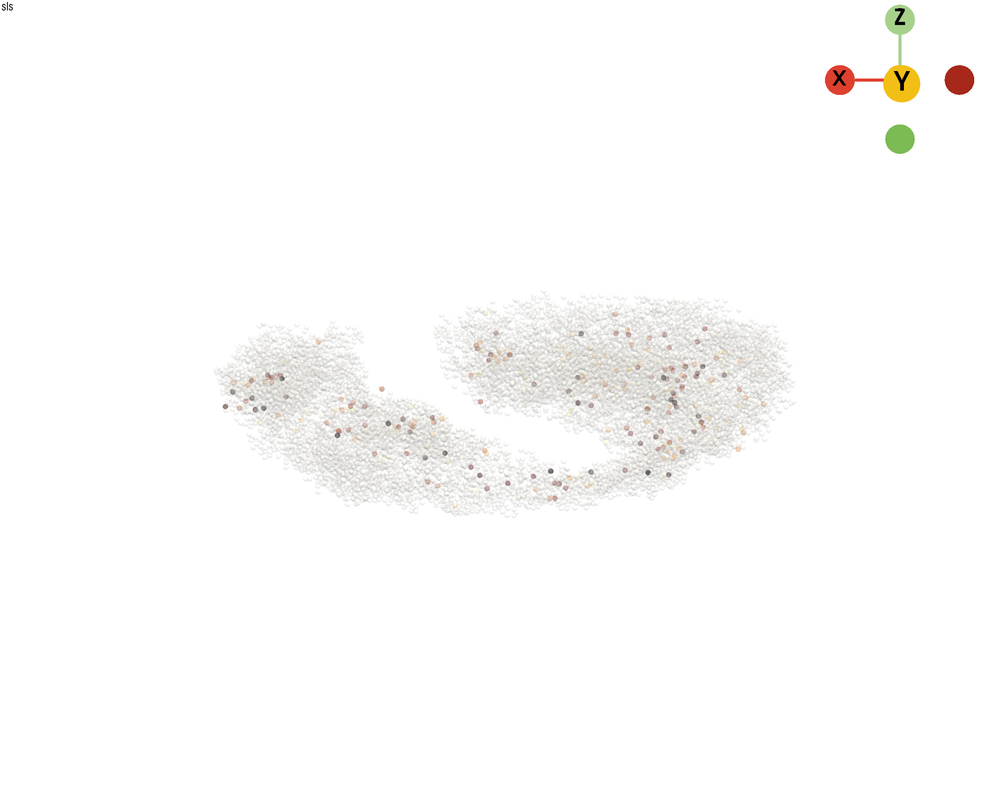

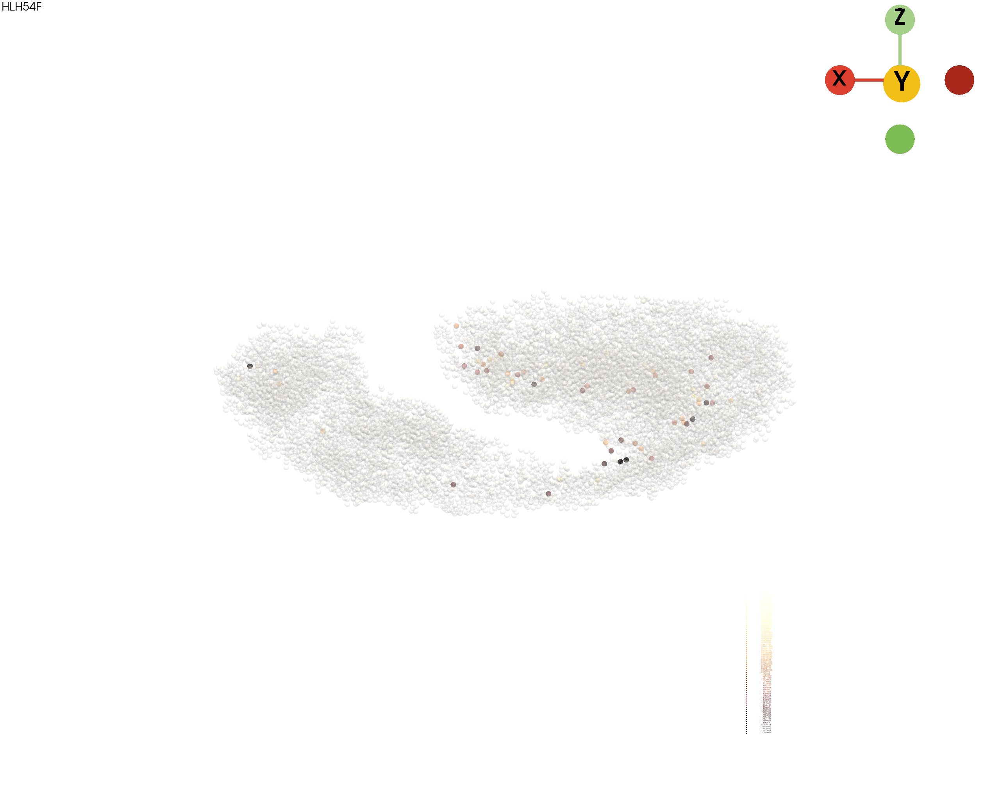

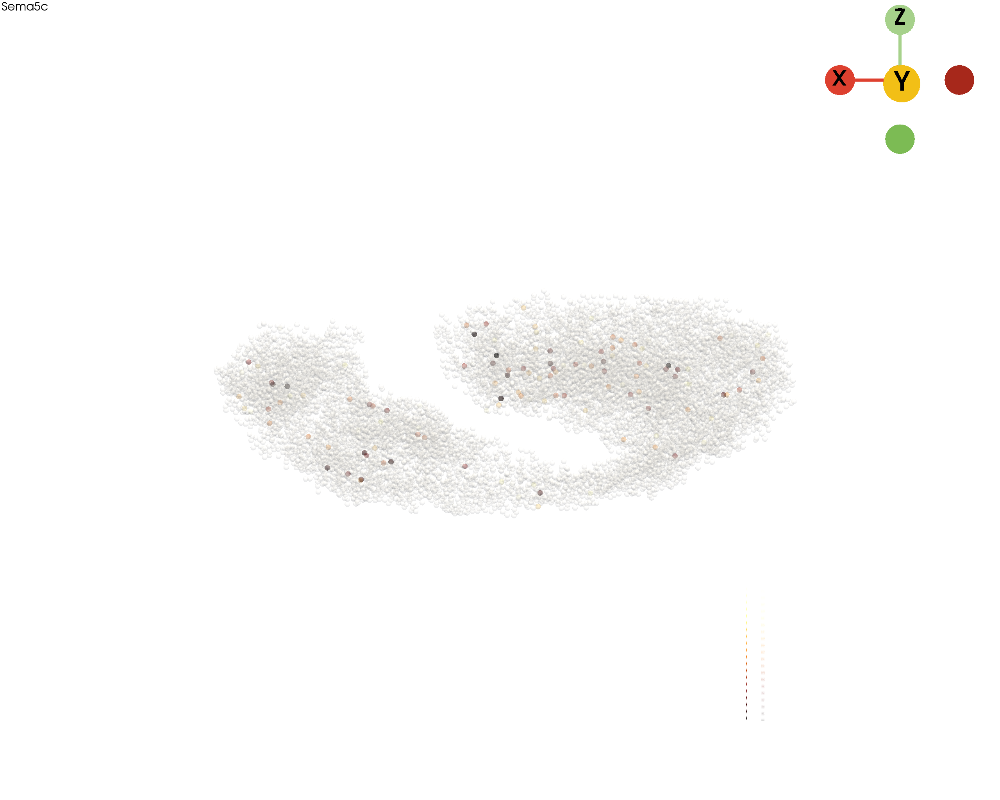

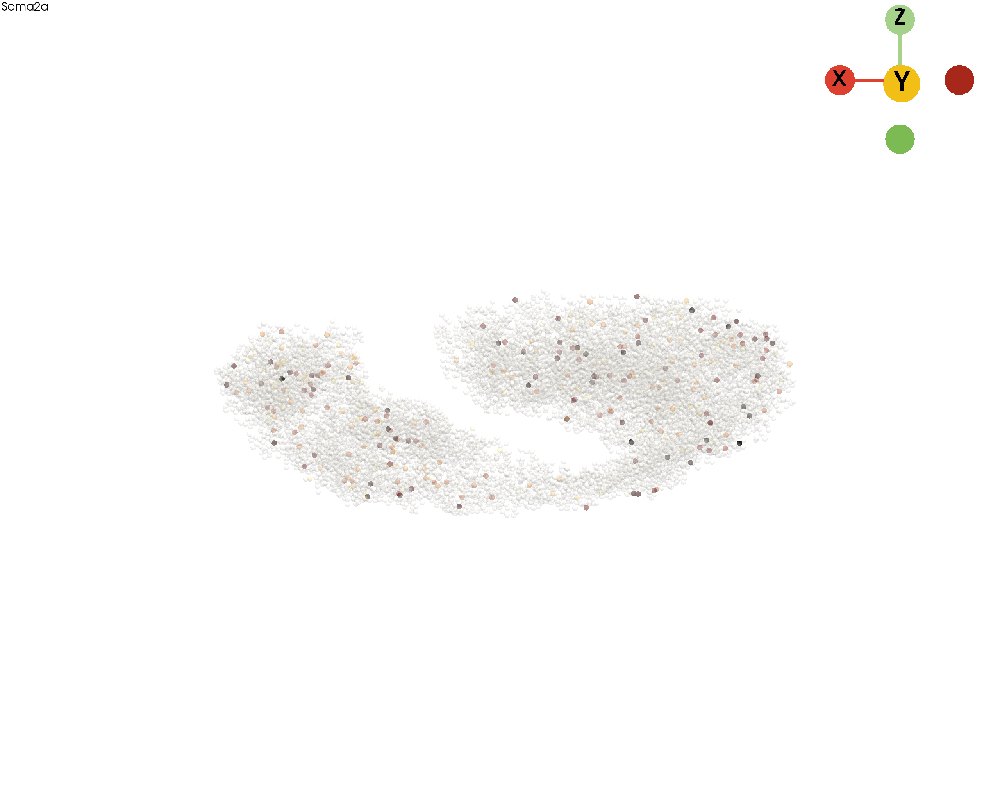

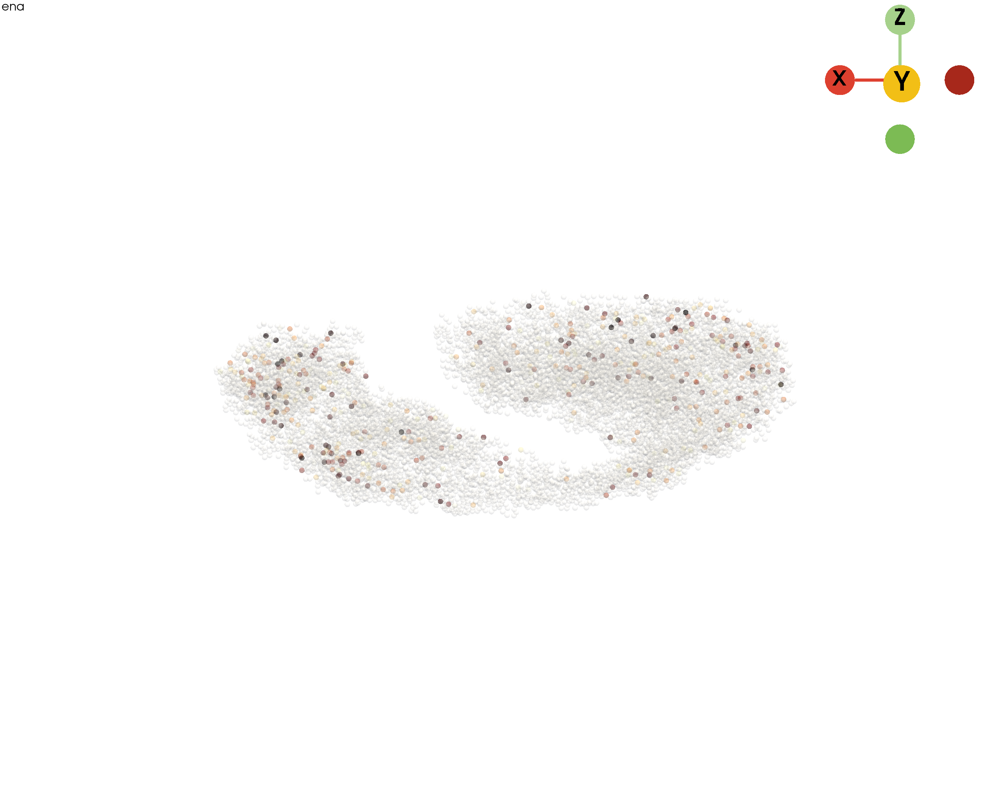

In [16]:
for gn in ["Orct2","rhea","Rac2","ena","peb","pcs","lmd","ewg","Vrp1","sls","HLH54F", "Sema5c","Sema2a","ena"]:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "morpho_curl_genes")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    
    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.2] = 0.2
    add_model_labels(model=germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter="static",
        #jupyter=False,
        #off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        # filename=os.path.join(out_image_genes, f"{sample_id}_germband_morpho_curl_model_{_gn}.pdf")
    )

In [28]:
for gn in selected_genes:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "morpho_curl_genes_colorbar")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    st.tdr.add_model_labels(model=germ_pc, labels=exp, key_added=gn, where="point_data",inplace=True, colormap="afmhot_r")

    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=0.4,
        colormap="afmhot_r",
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_genes, f"{sample_id}_germband_morpho_curl_model_{_gn}_with_colorbar.pdf")
    )

## GO term

In [5]:
import gseapy as gp
gp.get_library_name(organism="fly")

['Allele_LoF_Phenotypes_from_FlyBase_2017',
 'Allele_Phenotypes_from_FlyBase_2017',
 'Anatomy_AutoRIF',
 'Anatomy_AutoRIF_Predicted_zscore',
 'Anatomy_GeneRIF',
 'Anatomy_GeneRIF_Predicted_zscore',
 'Coexpression_Predicted_GO_Biological_Process_2018',
 'Coexpression_Predicted_GO_Cellular_Component_2018',
 'Coexpression_Predicted_GO_Molecular_Function_2018',
 'GO_Biological_Process_2018',
 'GO_Biological_Process_AutoRIF',
 'GO_Biological_Process_AutoRIF_Predicted_zscore',
 'GO_Biological_Process_GeneRIF',
 'GO_Biological_Process_GeneRIF_Predicted_zscore',
 'GO_Cellular_Component_2018',
 'GO_Cellular_Component_AutoRIF',
 'GO_Cellular_Component_AutoRIF_Predicted_zscore',
 'GO_Cellular_Component_GeneRIF',
 'GO_Cellular_Component_GeneRIF_Predicted_zscore',
 'GO_Molecular_Function_2018',
 'GO_Molecular_Function_AutoRIF',
 'GO_Molecular_Function_AutoRIF_Predicted_zscore',
 'GO_Molecular_Function_GeneRIF',
 'GO_Molecular_Function_GeneRIF_Predicted_zscore',
 'Human_Disease_from_FlyBase_2017',
 

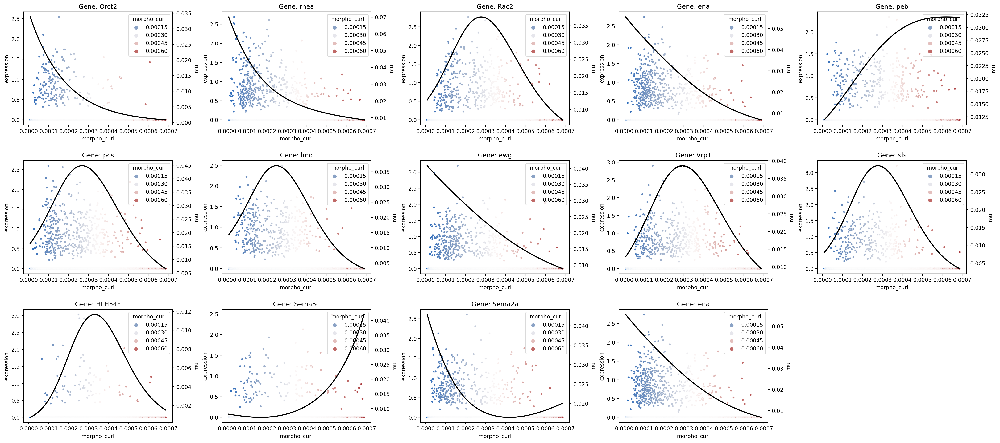

In [15]:
st.pl.glm_fit(
    adata=germ_adata,
    genes=["Orct2","rhea","Rac2","ena","peb","pcs","lmd","ewg","Vrp1","sls","HLH54F", "Sema5c","Sema2a","ena"],
    ncols=5,
    feature_x="morpho_curl",
    feature_y="expression",
    glm_key="glm_degs",
    save_show_or_return="show",
    color_key="morpho_curl",
    color_key_cmap="vlag",
    # save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_glm_degs_fit"), prefix=None, ext="pdf", dpi=100)
)

In [14]:
 # GO-biologial process
go_folder = os.path.join(out_image_path, f"{sample_id}_morpho_curl_GO_all")
Path(go_folder).mkdir(parents=True, exist_ok=True)
    
glm_data = germ_adata.uns["glm_degs"]["glm_result"]
glm_data= glm_data.loc[glm_data["log-likelihood"] >= -3000, :]
#glm_data= glm_data.loc[glm_data["log-likelihood"] <= -1000, :]
# glm_data= glm_data.loc[glm_data["pval"] >= 1e-10, :]
glm_data= glm_data.loc[glm_data["pval"] <= 1e-3, :]
selected_genes = list(glm_data.index)
go_bp = gp.enrichr(
        gene_list=selected_genes,
        gene_sets="GO_Biological_Process_2018",
        organism="fly",
        outdir=go_folder,
        no_plot=True,
        verbose=True
)

2023-09-18 23:18:09,209 [INFO] Run: GO_Biological_Process_2018 
2023-09-18 23:18:21,028 [INFO] Save enrichment results for GO_Biological_Process_2018 
2023-09-18 23:18:21,029 [INFO] Done.


In [32]:
go_bp_results = pd.read_csv(os.path.join(go_folder, f"GO_Biological_Process_2018.fly.enrichr.reports.txt"), sep="\t")
gp.barplot(go_bp_results, column='Combined Score', title='GO_Biological_Process_2018', cutoff=0.05, top_term=50, figsize=(5, 20),
            ofname=os.path.join(go_folder, f"{sample_id}_morpho_curl_go_bp_selected_barplot.pdf"))
gp.dotplot(go_bp_results, column='Combined Score', title='GO_Biological_Process_2023', cmap='viridis_r', cutoff=0.05, top_term=50, figsize=(5, 20),
            ofname=os.path.join(go_folder, f"{sample_id}_morpho_curl_go_bp_selected_dotplot.pdf"))

## Checking genes

In [ ]:
completed_data = []
for gn in selected_genes:
    data = germ_adata.uns["glm_degs"]["correlation"][gn]
    data = data[["morpho_curl", "expression"]]
    data = data[data["expression"] != 0]
    data["backbone_nodes"] = germ_adata.obs.loc[data.index, "backbone_nodes"]
    data["GNs"] = gn
    
    # data.sort_values(by="morpho_acceleration", ascending=True, axis=0, inplace=True)
    completed_data.append(data)

completed_data = pd.concat(completed_data, axis=0)
completed_data

In [ ]:
sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(40, 5))

# Plot the orbital period with horizontal boxes
sns.boxplot(x="GNs", y="morpho_curl", data=completed_data, whis=[0, 100], width=.6, palette="vlag")

# Tweak the visual presentation
ax.xaxis.grid(True)
sns.despine(trim=True, left=True)
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germ_layer_morpho_curl_glm_degs_boxplot.pdf"), dpi=300, format="pdf", bbox_inches="tight")
plt.show()

In [ ]:
completed_mean_data = []
for gn in glm_data.index:
    data = germ_adata.uns["glm_degs"]["correlation"][gn]
    data = data[["morpho_curl", "expression"]]
    data = data[data["expression"] != 0]
    data["backbone_nodes"] = germ_adata.obs.loc[data.index, "backbone_nodes"]
    mean_data = data.mean(axis = 0)
    mean_data["GNs"] = gn
    completed_mean_data.append(mean_data)

completed_mean_data = pd.concat(completed_mean_data, axis=1).T
completed_mean_data.sort_values(by="backbone_nodes", ascending=False, axis=0, inplace=True)
completed_mean_data.index = range(len(completed_mean_data.index))
print(completed_mean_data)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

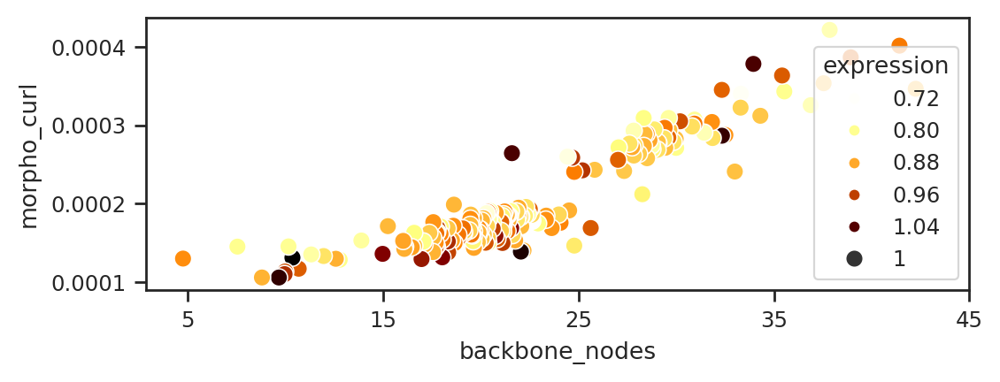

In [17]:
sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(6, 2))
sns.scatterplot(x="backbone_nodes", y="morpho_curl", data=completed_mean_data, hue="expression", palette="afmhot_r", size=1, sizes=(50, 100), ax=ax)
ax.set_xticks([5, 15, 25, 35, 45])
#scatter = ax.scatter(x=completed_mean_data["morpho_acceleration"], y=completed_mean_data["backbone_nodes"], c=completed_mean_data["expression"], vmin=0.6, vmax=1.1, cmap="afmhot_r")
#legend1 = ax.legend(*scatter.legend_elements(num=5), loc="upper left", title="Ranking")
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_glm_degs_mean_points.pdf"), dpi=300, format="pdf", bbox_inches="tight")
plt.show()

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

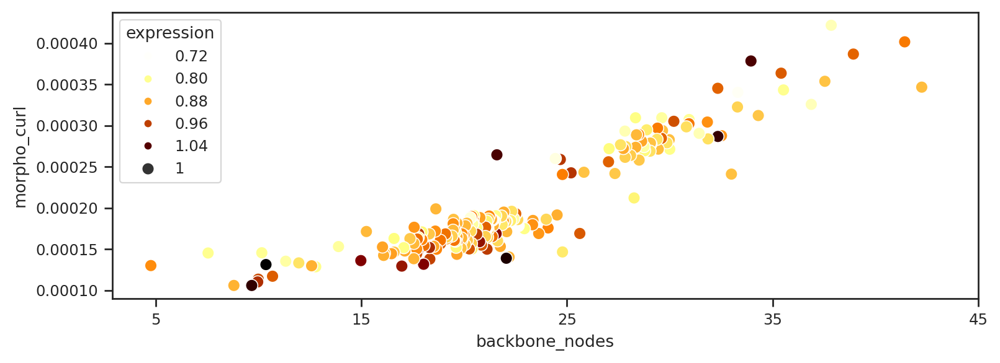

In [18]:
sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(9, 3))
sns.scatterplot(x="backbone_nodes", y="morpho_curl", data=completed_mean_data, hue="expression", palette="afmhot_r", size=1, sizes=(50, 100), ax=ax)
ax.set_xticks([5, 15, 25, 35, 45])
#scatter = ax.scatter(x=completed_mean_data["morpho_acceleration"], y=completed_mean_data["backbone_nodes"], c=completed_mean_data["expression"], vmin=0.6, vmax=1.1, cmap="afmhot_r")
#legend1 = ax.legend(*scatter.legend_elements(num=5), loc="upper left", title="Ranking")
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_glm_degs_mean_points_2.pdf"), dpi=300, format="pdf", bbox_inches="tight")
plt.show()

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

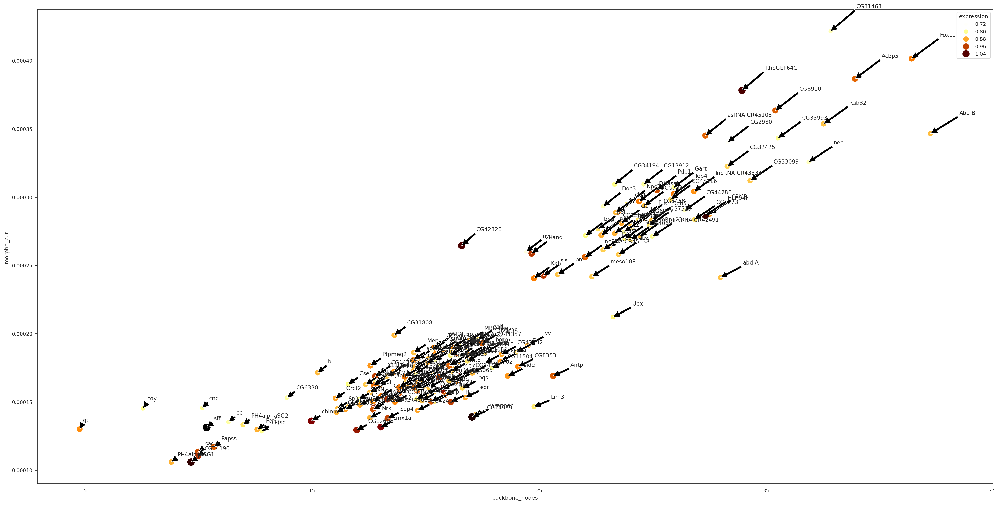

In [19]:
plt.show()
sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(30, 15))
sns.scatterplot(x="backbone_nodes", y="morpho_curl", data=completed_mean_data, hue="expression",
                size="expression", palette="afmhot_r", sizes=(40, 200), ax=ax)
ax.set_xticks([5, 15, 25, 35, 45])

for i in range(len(completed_mean_data)):
    data = completed_mean_data.iloc[i, :]
    ax.annotate(data["GNs"], xy=(data["backbone_nodes"], data["morpho_curl"]),
                xytext=(data["backbone_nodes"] * 1.03, data["morpho_curl"] * 1.04),
                arrowprops=dict(facecolor='black', shrink=0.001))
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_morpho_curl_glm_degs_mean_points_with_labels.pdf"),
            dpi=300, format="pdf", bbox_inches="tight")
plt.show()

## Save curl_related anndata object

In [43]:
germ_adata

AnnData object with n_obs × n_vars = 12585 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho', 'glm_degs', 'log1p', 'pp'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

In [46]:
germ_adata.write_h5ad(f"h5ad/{sample_id}_germband_v4_curl.h5ad", compression="gzip")

In [4]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband_v4_curl.h5ad")

In [5]:
glm_data = germ_adata.uns["glm_degs"]["glm_result"]
selected_genes = ["Acbp5", "Abd-B", "fkh", "nyo", "Dph5", "CG6910", "CG7841", "CG7519", "tai", "Rab32", "Gart", "CG31463", "tai", "CG7519",
                  "CG33993", "CG33099", "CG2930", "RhoGEF64C", "CG44286", "neo", "FoxL1", "CG1273", "Tep4", "bbg", "Doc3", "CG4069",
                  "CG32425", "Npc2g", "Pdp1", "fok", "DNaseII", "CG6937", "CG8468", "clu", "CG11563", "Galt", "Surf6", "ppl", "CG12522", "mRpL23", "Chchd2", "ppan", "peb"]
glm_data = glm_data.loc[selected_genes, :]
glm_data.to_csv(os.path.join(out_image_path, f"Germband_curl_selected_glm_degs.csv"), sep="\t")
glm_data

,status,family,log-likelihood,pval,qval
Acbp5,ok,NB2,-446.325439,7.735238e-40,3.694712e-37
Abd-B,ok,NB2,-776.600220,2.007081e-31,6.518998e-29
fkh,ok,NB2,-993.796814,3.128848e-12,2.190194e-10
nyo,ok,NB2,-235.369095,4.795965e-10,2.528782e-08
Dph5,ok,NB2,-941.847900,1.469076e-09,7.229635e-08
CG6910,ok,NB2,-241.193802,1.572314e-09,7.645021e-08
CG7841,ok,NB2,-665.780579,1.606620e-09,7.765329e-08
CG7519,ok,NB2,-958.068726,9.779905e-06,1.946393e-04
tai,ok,NB2,-745.737732,9.469659e-06,1.898608e-04
Rab32,ok,NB2,-257.378418,2.108491e-09,9.896500e-08
